In [1]:
# This Notebook loads a dataset to memory, calculates NBR2, and plots the results, using a cloud mask.

In [2]:
import datacube
from datacube.api.query import Query
from datacube.storage.masking import mask_invalid_data

dc = datacube.Datacube()

In [57]:
# Get user input

b1 = 3
b2 = 5

# Select a product
p = 'LC08_scene'

# Select available regions
nwt = False            # example of burn 
vi = False             # example of coastal area
ll = False             # example of surface mine 



# Select time start and end
t1 = ''
t2 = ''


In [58]:
# Prepare the DB query

b1, b2 = map(lambda x: x + 1,[b1, b2])


if nwt :
    lat = (62.3768, 63.3062)
    lon = (-114.7038, -112.3989)
elif vi :
    lat = (47.9432, 49.4273)
    lon = (-123.7845, -121.2920)
elif ll :
    lat = (49.7178, 50.8349)
    lon = (-122.2683, -119.1079)
# Petawawa is default selection
else :
    lat = (45.4499, 46.6034)
    lon = (-78.4944, -76.7130)    
   

    
LC08_Bands = ['coastal_aerosol', 'blue', 'green', 'red', 'nir', 'swir1', 'swir2', 'panchromatic', 'cirrus', 'lwir1', 'lwir2', 'quality']


query = { 
    'product' : p
    , 'latitude' : lat
    , 'longitude' : lon
    , 'measurements' : [ LC08_Bands[b1], LC08_Bands[b2] ]
    , 'resolution' : (-0.0025, 0.0025)
}

if (t1 != '') and (t2 != '') :
    query['time'] = (t1, t2)

In [59]:
# Explore datacube records to locate datasets of interest
dc.find_datasets(**query)

[Dataset <id=d73f8bfe-8d95-526a-a42c-c21733f92be3 type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20171226_20180103_01_T1/metadata.yaml>,
 Dataset <id=6d228759-d2cd-5306-a8d6-9522168ce63f type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20170921_20171012_01_T1/metadata.yaml>,
 Dataset <id=c41be1b9-f985-54c6-a6f9-353af4fb3840 type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20170820_20170826_01_T1/metadata.yaml>,
 Dataset <id=9aa28340-881f-5e65-8417-7b2530b42ca2 type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20170703_20170715_01_T1/metadata.yaml>,
 Dataset <id=4b7dea5d-8e57-5c51-bdfe-a42ec792e118 type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20170414_20170501_01_T1/metadata.yaml>,
 Dataset <id=de4f6f7a-9366-5cdb-afcc-baa1d6b31d7b type=LC08_scene location=/data/datacube/in/landsat/LC08_L1TP_017028_20170209_20170217_01_T1/metadata.yaml>,
 Dataset <id=1e3c267e-f155-55e9-814f-7eaf76afe126 ty

In [60]:
# Query the datacube and load datasets to memory
data = dc.load(**query)

In [61]:
# Isolate all valid data in the the two bands of interest
band1 = mask_invalid_data(data)

band1 = data.data_vars[LC08_Bands[b1]].where(data.data_vars[LC08_Bands[b1]] != data.data_vars[LC08_Bands[b1]].attrs['nodata'])
band2 = data.data_vars[LC08_Bands[b2]].where(data.data_vars[LC08_Bands[b2]] != data.data_vars[LC08_Bands[b2]].attrs['nodata'])

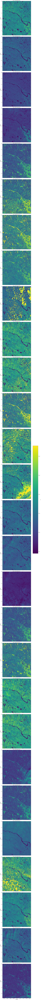

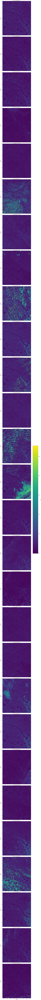

In [62]:
# Visualize band data

band1.plot(col='time', col_wrap = 1, size = 10)
band2.plot(col='time', col_wrap = 1, size = 10)

In [63]:
#Calculate and visualize the index
index = ((band1 - band2) / (band1 + band2))

In [64]:
# preNDB2.plot(col='time', col_wrap = 1, size = 15)
# The data structure is an xarray, and borrows logic from Seaborn to infer what kind of color map to use.
# https://seaborn.pydata.org/tutorial/color_palettes.html

index.plot(col='time', col_wrap = 1, size = 15)